In [87]:
import numpy as np
import matplotlib.pyplot as plt
import math
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 100

## Questão 1 (Medida e Vetores):

Faça a conversão de unidades conforme solicitado nos itens abaixo, sempre usando 4 casas decimais, se necessário:

a) $\frac{cm}{h}$ $\Rightarrow$ $\frac{m}{s}$

b) libra $\Rightarrow$ onça (oz) $\Rightarrow$ quilograma (Kg)

c) erg/s (CSG) para Watts (SI)

d) parsec $\Rightarrow$ m sabendo que 1 parsec vale aproximadamente 3,26 anos-luz. Calcule o valor do ano luz em m partindo da velocidade da luz (c) e converta parsec (pc) para metro.


### RESOLUÇÃO:

In [88]:
# a)
def item_a():
    """converte 1 centímetro por hora (cm/h) para metros por segundo (m/s)"""

    # convertendo unidades básicas
    # cm → m: 1 cm = 1e-2 m
    # h → s: 1 h = 3600 s
    CM_TO_M = 1e-2
    H_TO_S = 3600.0

    # valor base pedido no enunciado: 1 cm/h
    cm_per_h = 1.0

    # regra de três direta: (cm/h) * (m/cm) / (s/h) = m/s
    m_per_s = cm_per_h * CM_TO_M / H_TO_S

    # nota: usamos notação científica pois o resultado é muito pequeno
    return m_per_s

a = item_a()
print(f"1 cm/h = {a:.4e} m/s")

1 cm/h = 2.7778e-06 m/s


In [89]:
# b)
def item_b():
    """converte 1 libra (lb) para onças (oz) e para quilogramas (kg)"""

    # fatores exatos do sistema avoirdupois
    # 1 lb = 16 oz (definição)
    # 1 lb = 0.45359237 kg (exato pelo SI)
    LB_TO_OZ = 16.0
    LB_TO_KG = 0.45359237

    # valor base pedido no enunciado: 1 libra
    lb = 1.0

    # conversões diretas
    ounces = lb * LB_TO_OZ
    kilograms = lb * LB_TO_KG

    # retornamos ambos para poder imprimir as duas unidades com 4 casas
    return {"oz": ounces, "kg": kilograms}

b = item_b()
# 16.0000 oz: valor exato por definição, 4 casas decimais adequadas para conversões de massa
print(f"1 lb = {b['oz']:.4f} oz")
# 0.4536 kg: 4 casas decimais adequadas para precisão em conversões de massa
print(f"1 lb = {b['kg']:.4f} kg")

1 lb = 16.0000 oz
1 lb = 0.4536 kg


In [90]:
# c)
def item_c():
    """converte 1 erg/s (CGS) para watt (SI)"""

    # relação fundamental de energia entre sistemas:
    # 1 erg = 1e-7 joule (definição CGS → SI)
    ERG_TO_J = 1e-7

    # potência é energia por tempo, então 1 erg/s = (1e-7 J)/s = 1e-7 W
    watts = ERG_TO_J

    # notação científica deixa claro a ordem de grandeza
    return watts

c = item_c()
print(f"1 erg/s = {c:.4e} W")

1 erg/s = 1.0000e-07 W


In [91]:
# d)
def item_d():
    """calcula 1 ano-luz em metros a partir de c e converte 1 parsec para metros usando 1 pc ≈ 3,26 ly"""

    # velocidade da luz no vácuo (exata no SI)
    c_m_per_s = 299_792_458.0  # m/s

    # duração do ano para definir o ano-luz: usamos o ano juliano padrão da astronomia
    # 1 ano = 365,25 dias e 1 dia = 86400 s
    DAYS_PER_YEAR = 365.25
    SECONDS_PER_DAY = 86_400.0
    seconds_per_year = DAYS_PER_YEAR * SECONDS_PER_DAY  # s

    # 1 ano-luz = c * tempo de 1 ano
    light_year_m = c_m_per_s * seconds_per_year  # m

    # aproximação dada no enunciado: 1 pc ≈ 3,26 anos-luz
    PC_IN_LY = 3.26
    parsec_m = PC_IN_LY * light_year_m  # m

    # retornamos ambos para exibir claramente as duas grandezas pedidas
    return {"ly_m": light_year_m, "pc_m": parsec_m}

d = item_d()
print(f"1 ano-luz = {d['ly_m']:.4e} m")
print(f"1 parsec ≈ {d['pc_m']:.4e} m")

1 ano-luz = 9.4607e+15 m
1 parsec ≈ 3.0842e+16 m


## Questão 2 (Medida e Vetores):

Um avião sai de Brasília com direção á Belo Horizonte com uma velocidade $\vec{V_0} = 55$ nós por 452 Km através da geodésica, esse deslocamento acontece em um ângulo de -46,4° em relação à linha do equador. Em seguida viaja a uma velocidade constante entre Belo Horizonte e Salvador, percorrendo 1200 Km em 1h 45min em linha reta, formando um ângulo de 53,13° entre o vetor deslocamento e a linha do equador. Esse mesmo avião volta de Salvador para Brasília em um total de 1h 55min. A partir das informações acima calcule:

a) O vetor velocidade do avião no trajeto Belo Horizonte $⇒$ Salvador.

b) A distância em linha reta entre Salvador e Brasília.

c) Defina a posição cartesiana de cada uma das cidades.

d) O vetor de deslocamento total realizado no trajeto.

e) O vetor velocidade do avião no trajeto Salvador $⇒$ Brasília.

f) O vetor de velocidade média total da viagem.

g) A rapidez média do trajeto.

Considere todos os movimentos retilíneos em um plano cartesiano e Brasília localizado na origem (0,0).

###

In [92]:
"""
 NÃO ALTERE ESSA CÉLULA
"""

def Plot_vetor_velocidade(ax, comprimento_x, comprimento_y, rotulo, origin=(0,0), color='blue'):
    x0, y0 = origin
    dx, dy = comprimento_x, comprimento_y

    ax.scatter(x0, y0, color=color, s=30, zorder=5)

    ax.quiver(x0, y0, dx, 0, angles='xy', scale_units='xy',
              color=color, width=.003, alpha=.6, scale=2)
    ax.text(x0 + dx/2, y0 - 0.3, "v_x", color='black')

    ax.quiver(x0, y0, 0, dy, angles='xy', scale_units='xy',
              color=color, width=.003, alpha=.6, scale=2)

    ax.text(x0 - 0.3, y0 + dy/2, "v_y", color='black')

    ax.quiver(x0, y0, dx, dy, angles='xy', scale_units='xy',
              color=color, width=.005, label=rotulo, scale=2)

    return ax


def Plot_vetor_deslocamento(ax, comprimento_x, comprimento_y, rotulo, origin=(0,0), color='black'):
    x0, y0 = origin
    dx, dy = comprimento_x, comprimento_y

    ax.quiver(x0, y0, dx, dy, angles='xy', scale_units='xy',
              color=color, width=.004, label=rotulo, scale=1)

    return ax

### RESOLUÇÃO:

In [93]:
# a)

def Calculo_velocidade_BH_SALVADOR():
    """retorna as componentes (vx, vy) da velocidade média no trecho bh -> salvador, em km/h"""

    # dados do trecho bh -> salvador
    # distância em linha reta: 1200 km
    # tempo: 1 h 45 min = 1.75 h
    # ângulo do deslocamento em relação ao equador: +53.13°
    dist_km = 1200.0
    time_h = 1.0 + 45.0/60.0
    theta_deg = 53.13

    # calcula o módulo da velocidade média v = Δs/Δt (unidade: km/h)
    v_mag_kmh = dist_km / time_h

    # decompõe a velocidade nas direções x (leste) e y (norte)
    theta_rad = math.radians(theta_deg)
    vx_kmh = v_mag_kmh * math.cos(theta_rad)
    vy_kmh = v_mag_kmh * math.sin(theta_rad)

    return vx_kmh, vy_kmh


In [94]:
# b)

def Distancia_SALVADOR_BRASILIA():
    """retorna a distância em linha reta (km) entre salvador e brasília, a partir das posições calculadas"""

    # 1º trecho: brasília (0,0) -> belo horizonte
    d1_km = 452.0
    ang1_deg = -46.4
    bh_x = d1_km * math.cos(math.radians(ang1_deg))
    bh_y = d1_km * math.sin(math.radians(ang1_deg))

    # 2º trecho: belo horizonte -> salvador
    d2_km = 1200.0
    ang2_deg = 53.13
    ssa_x = bh_x + d2_km * math.cos(math.radians(ang2_deg))
    ssa_y = bh_y + d2_km * math.sin(math.radians(ang2_deg))

    # distância de salvador até brasília (origem)
    dist_km = math.hypot(ssa_x, ssa_y)
    return dist_km


In [95]:
# c)

def Posicao_BRASILIA():
    """retorna a posição cartesiana de brasília (origem), em km"""
    # brasília é a origem do sistema de referência
    pos_x, pos_y = 0.0, 0.0
    return pos_x, pos_y


def Posicao_BELO_HORIZONTE():
    """retorna a posição cartesiana de belo horizonte (km) a partir do deslocamento inicial"""

    # deslocamento bsb -> bh: 452 km com ângulo -46.4° em relação ao equador
    d1_km = 452.0
    ang1_deg = -46.4
    x = d1_km * math.cos(math.radians(ang1_deg))
    y = d1_km * math.sin(math.radians(ang1_deg))
    return x, y


def Posicao_SALVADOR():
    """retorna a posição cartesiana de salvador (km) somando o deslocamento bh -> ssa"""

    # posição de bh
    bh_x, bh_y = Posicao_BELO_HORIZONTE()

    # deslocamento bh -> ssa: 1200 km a 53.13°
    d2_km = 1200.0
    ang2_deg = 53.13
    dx = d2_km * math.cos(math.radians(ang2_deg))
    dy = d2_km * math.sin(math.radians(ang2_deg))

    # posição final de salvador
    ssa_x = bh_x + dx
    ssa_y = bh_y + dy
    return ssa_x, ssa_y


In [96]:
# d)

def Vetor_DESLOCAMENTO():
    """retorna o vetor deslocamento total (Δx, Δy) da viagem completa, em km"""

    # soma vetorial dos três trechos: bsb->bh, bh->ssa e ssa->bsb
    bsb_x, bsb_y = 0.0, 0.0
    bh_x, bh_y = Posicao_BELO_HORIZONTE()
    ssa_x, ssa_y = Posicao_SALVADOR()

    # deslocamentos parciais
    dx1, dy1 = bh_x - bsb_x, bh_y - bsb_y
    dx2, dy2 = ssa_x - bh_x, ssa_y - bh_y
    dx3, dy3 = bsb_x - ssa_x, bsb_y - ssa_y

    # deslocamento total (espera-se (0,0) pois retorna ao ponto de partida)
    total_dx = dx1 + dx2 + dx3
    total_dy = dy1 + dy2 + dy3
    return total_dx, total_dy


In [97]:
# e)

def Calculo_velocidade_SALVADOR_BRASILIA():
    """retorna as componentes (vx, vy) da velocidade média no trecho salvador -> brasília, em km/h"""

    # tempo total do trecho ssa -> bsb: 1 h 55 min = 1.9166... h
    time_h = 1.0 + 55.0/60.0

    # deslocamento ssa -> bsb é o vetor que leva de salvador até a origem
    ssa_x, ssa_y = Posicao_SALVADOR()
    dx = 0.0 - ssa_x
    dy = 0.0 - ssa_y

    # velocidade média vetorial v = Δr/Δt (unidade: km/h)
    vx_kmh = dx / time_h
    vy_kmh = dy / time_h
    return vx_kmh, vy_kmh


In [98]:
# f)

def Vetor_VELOCIDADE_MEDIA():
    """retorna o vetor velocidade média de toda a viagem (km/h)"""

    # tempo total = t1 + t2 + t3
    # t1: bsb->bh com 55 nós; 1 nó = 1.852 km/h (exato)
    dist1_km = 452.0
    speed1_kmh = 55.0 * 1.852
    t1_h = dist1_km / speed1_kmh

    # t2: 1 h 45 min
    t2_h = 1.0 + 45.0/60.0

    # t3: 1 h 55 min
    t3_h = 1.0 + 55.0/60.0

    total_time_h = t1_h + t2_h + t3_h

    # deslocamento total da viagem: retorna ao ponto de partida → vetor nulo
    total_dx, total_dy = Vetor_DESLOCAMENTO()

    # velocidade média vetorial = deslocamento total / tempo total
    vx_avg = total_dx / total_time_h
    vy_avg = total_dy / total_time_h
    return vx_avg, vy_avg


In [99]:
# g)

def Rapidez_MEDIA():
    """retorna a rapidez média (km/h) = distância total percorrida / tempo total"""

    # distâncias dos trechos
    d1_km = 452.0
    d2_km = 1200.0
    d3_km = Distancia_SALVADOR_BRASILIA()

    total_dist_km = d1_km + d2_km + d3_km

    # tempos dos trechos
    speed1_kmh = 55.0 * 1.852  # conversão de nós para km/h
    t1_h = d1_km / speed1_kmh
    t2_h = 1.0 + 45.0/60.0
    t3_h = 1.0 + 55.0/60.0
    total_time_h = t1_h + t2_h + t3_h

    # rapidez média = caminho total / tempo total
    v_avg_kmh = total_dist_km / total_time_h
    return v_avg_kmh


In [101]:
def Questão_2():
  """
    DICA: COMENTE OS ITENS QUE AINDA NÃO FOREM FEITOS NA FUNÇÃO ABAIXO.
    SERÁ MAIS FÁCIL DE CONFERIR A RESPOSTA DURANTE A COMPILAÇÃO DO EXERCÍCIO.
  """

  fig, ax = plt.subplots(1, figsize = (10, 10))

  # A
  velocidade_BH_SALVADOR_x, velocidade_BH_SALVADOR_y = Calculo_velocidade_BH_SALVADOR()
  print(f"Velocidade no trajeto BH -> Salvador: Vx = {velocidade_BH_SALVADOR_x:.4f} km/h, Vy = {velocidade_BH_SALVADOR_y:.4f} km/h")

  # B
  distancia_SALVADOR_BRASILIA = Distancia_SALVADOR_BRASILIA()
  print(f"A distância em linha reta entre Salvador e Brasília é {distancia_SALVADOR_BRASILIA:.4f} km")

  # c
  posicao_BRASILIA_x, posicao_BRASILIA_y = Posicao_BRASILIA()
  posicao_BELO_HORIZONTE_x, posicao_BELO_HORIZONTE_y = Posicao_BELO_HORIZONTE()
  posicao_SALVADOR_x, posicao_SALVADOR_y = Posicao_SALVADOR()

  # Posições em km: 2 casas decimais adequadas para distâncias geográficas
  brasilia_pos = Posicao_BRASILIA()
  print(f"Posição de Brasília: ({brasilia_pos[0]:.2f}, {brasilia_pos[1]:.2f}) km")
  
  bh_pos = Posicao_BELO_HORIZONTE()
  print(f"Posição de Belo Horizonte: ({bh_pos[0]:.2f}, {bh_pos[1]:.2f}) km")
  
  salvador_pos = Posicao_SALVADOR()
  print(f"Posição de Salvador: ({salvador_pos[0]:.2f}, {salvador_pos[1]:.2f}) km")

  # D
  dx, dy = Vetor_DESLOCAMENTO()
  print(f"Vetor deslocamento total = ({dx:.4f}, {dy:.4f}) km")

  # E
  velocidade_SALVADOR_BRASILIA_x, velocidade_SALVADOR_BRASILIA_y = Calculo_velocidade_SALVADOR_BRASILIA()
  print(f"Velocidade no trajeto Salvador -> Brasília: Vx = {velocidade_SALVADOR_BRASILIA_x:.4f} km/h, Vy = {velocidade_SALVADOR_BRASILIA_y:.4f} km/h")

  # F
  vx, vy = Vetor_VELOCIDADE_MEDIA()
  print(f"Vetor velocidade média total = ({vx:.4f}, {vy:.4f}) km/h")

  # G
  v_media = Rapidez_MEDIA()
  print(f"Rapidez = {v_media:.4f} km/h")

  ax.scatter(posicao_BRASILIA_x, posicao_BRASILIA_y, label="Brasília", marker='s', s=50)
  ax.scatter(posicao_BELO_HORIZONTE_x, posicao_BELO_HORIZONTE_y, label="Belo Horizonte", marker='s', s=50)
  ax.scatter(posicao_SALVADOR_x, posicao_SALVADOR_y, label="Salvador", marker='s', s=50)

  """
  BRASILIA - BELO HORIZONTE
  """
  Plot_vetor_deslocamento(ax, posicao_BELO_HORIZONTE_x-posicao_BRASILIA_x, posicao_BELO_HORIZONTE_y-posicao_BRASILIA_y, origin=(posicao_BRASILIA_x, posicao_BRASILIA_y), rotulo='Deslocamento_BSB -> BH', color='navy')

  """
  BELO HORIZONTE - SALVADOR
  """

  velocidade_BRASILIA_BH_x, velocidade_BRASILIA_BH_y = Calculo_velocidade_BH_SALVADOR()

  Plot_vetor_deslocamento(ax, posicao_SALVADOR_x-posicao_BELO_HORIZONTE_x, posicao_SALVADOR_y-posicao_BELO_HORIZONTE_y, origin=(posicao_BELO_HORIZONTE_x, posicao_BELO_HORIZONTE_y), rotulo='Deslocamento_BH -> SSA', color='peru')
  Plot_vetor_velocidade(ax, velocidade_BRASILIA_BH_x, velocidade_BRASILIA_BH_y, origin=(posicao_BELO_HORIZONTE_x, posicao_BELO_HORIZONTE_y), color='orange', rotulo='Vel_BH -> SSA')

  """
  SALVADOR - BR
  """

  velocidade_SALVADOR_BRASILIA_x, velocidade_SALVADOR_BRASILIA_y = Calculo_velocidade_SALVADOR_BRASILIA()

  Plot_vetor_deslocamento(ax,comprimento_x=(posicao_BRASILIA_x-posicao_SALVADOR_x),comprimento_y=(posicao_BRASILIA_y-posicao_SALVADOR_y),rotulo='Deslocamento_BSB -> BH',origin=(posicao_SALVADOR_x, posicao_SALVADOR_y), color='limegreen')
  Plot_vetor_velocidade(ax, velocidade_SALVADOR_BRASILIA_x, velocidade_SALVADOR_BRASILIA_y, origin=(posicao_SALVADOR_x, posicao_SALVADOR_y), color='green', rotulo='Vel_BH -> SSA' )

  ax.legend()

  plt.grid(True)

  plt.show()

Velocidade no trajeto BH -> Salvador: Vx = 411.4296 km/h, Vy = 548.5707 km/h
A distância em linha reta entre Salvador e Brasília é 1210.2480 km
Posição de Brasília: (0.00, 0.00) km
Posição de Belo Horizonte: (311.71, -327.33) km
Posição de Salvador: (1031.71, 632.67) km
Vetor deslocamento total = (0.0000, 0.0000) km
Velocidade no trajeto Salvador -> Brasília: Vx = -538.2833 km/h, Vy = -330.0903 km/h
Vetor velocidade média total = (0.0000, 0.0000) km/h
Rapidez = 353.1839 km/h


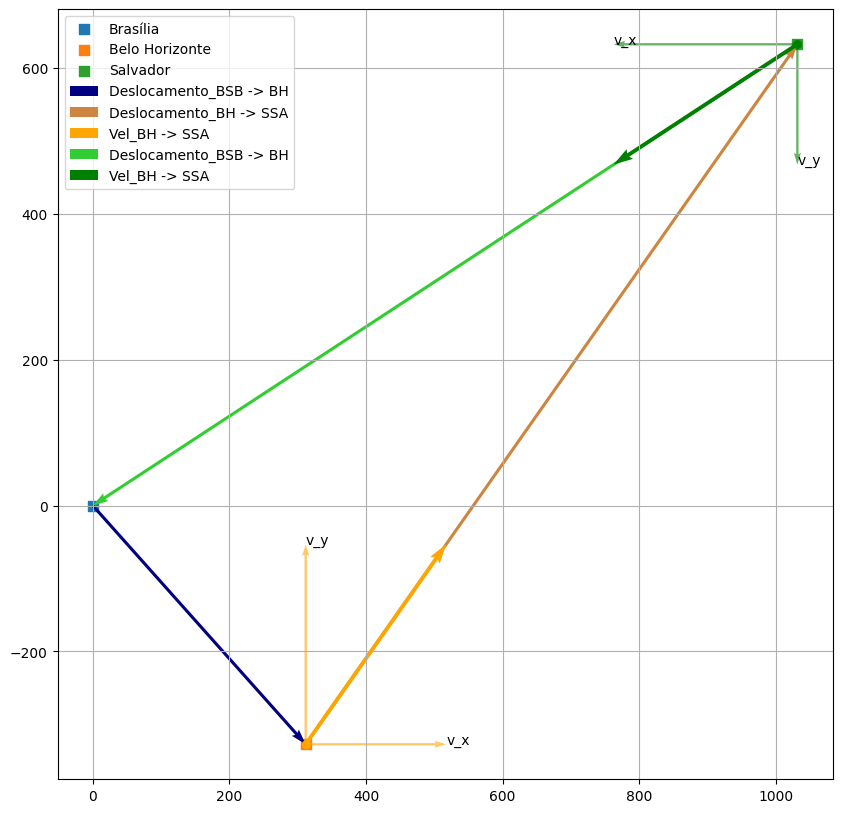

In [102]:
# Rodar essa célula para verificar as respostas da questão 2:
Questão_2()

# Questão 3 (Movimento unidimensional):
## Regra de Simpson 1/3 – Integração Numérica

A **regra de Simpson 1/3** é um método para aproximar a integral definida de uma função \( f(x) \) no intervalo \([a, b]\).  

Ela funciona melhor quando o **número de subintervalos \(N\) é par**, porque cada par de subintervalos é aproximado por uma parábola.


### Passos para usar Simpson 1/3

1. **Escolha o número de subintervalos \(N\) par**.

$
h = \frac{b-a}{N}
$

2. **Defina os pontos do intervalo**:

$
x_n \equiv x_0 + n h, \quad (n = 0, \pm 1, \pm 2, \dots)
$

$
x_0 = a, \, x_1 = a+h, \, x_2 = a+2h, \dots, x_N = b
$

3. **Avalie a função em cada ponto**:


$
f_n \equiv f(x_n) = f(x_0 + n h), \quad (n = 0, \pm 1, \pm 2, \dots)
$

$
f_i = f(x_i)
$

4. **Aplique a fórmula de Simpson 1/3**:

$
\int_a^b f(x)\, dx \approx \frac{h}{3} \left[ f_0 + 4\sum_{i (impar)} f_i + 2\sum_{i (par)}^{i \ne N} f_i  + f_N \right]
$

- ($f_0$) e ($f_N$) → peso 1  

- ($f_1$, $f_3$, $f_5$, $\dots$) → peso 4  

- ($f_2$, $f_4$, $\dots$) (exceto extremos) → peso 2

---

# Exercício – Movimento com aceleração variável

Uma partícula move-se ao longo de uma linha reta com aceleração:

$$
a(t) = t \sqrt{1 + t^2} \quad [\text{m/s²}]
$$

Se a partícula parte do repouso no instante $t = 0$:

a) Determine a velocidade da partícula no intervalo $t = 0$ até $t = 3 \, \text{s}$ utilizando o método de Simpson 1/3 para calcular o valor da velocidade. Em seguida, compare o valor obtido pelo método e compare com a integral calculada no método convencional. Calcule para N = 24 e N = 48.

b) Determine o deslocamento da partícula nesse mesmo intervalo integrando por Simpson com N = 24 e compare com o valor calculada no método convencional.


###

In [103]:
"""
 NÃO ALTERE ESSA CÉLULA
"""

def Plot_velocidade(ax, x, tipo):
  if tipo == 'plot':
    ax.plot(x, velocidade(x), color='blue', label='v(t)')
  elif tipo == 'scatter':
    ax.scatter(x, velocidade(x), color='red', label='v(x_i)')

  return ax

def Plot_aceleracao(ax, x, tipo):
  if tipo == 'plot':
    ax.plot(x, aceleracao(x), color='blue', label='a(t)')
  elif tipo == 'scatter':
    ax.scatter(x, aceleracao(x), color='red', label='a(x_i)')

  return ax

### RESOLUÇÃO:

##  Discussão do Item (a) - Análise da Integração Numérica

### **Por que N deve ser par?**

A regra de Simpson 1/3 aproxima a integral por **parábolas em pares de subintervalos**. 

**Estrutura necessária:**
- Blocos consecutivos: `[x₀, x₁, x₂] → [x₂, x₃, x₄] → [x₄, x₅, x₆] → ...`
  
- **Pesos:** `1 – 4 – 2 – 4 – 2 – 4 – ... – 2 – 4 – 1`


### **Solução Analítica para a Velocidade**

**Dedução da expressão exata:**

- **Aceleração dada:** $a(t) = t\sqrt{1 + t^2}$
- **Integrando de 0 a t com v(0) = 0:**
  $$\int_0^t t\sqrt{1 + t^2} \, dt$$

- **Substituição:** $u = 1 + t^2$, $du = 2t \, dt$
  $$\frac{1}{2}\int u^{1/2} \, du = \frac{1}{3}u^{3/2} + C$$

- **Resultado:** $v(t) = \frac{(1+t^2)^{3/2} - 1}{3}$ **[m/s]**

**Valor de referência em t = 3s:**
$$v(3) = \frac{(1+9)^{3/2} - 1}{3} = \frac{10^{3/2} - 1}{3} \approx \mathbf{10.2080} \text{ m/s}$$


### **Análise da Convergência do Método de Simpson**

**Teoria da convergência:**
- **Erro global:** $\mathcal{O}(h^4)$
- **Ao dobrar N (24 → 48):** passo h cai pela metade
- **Esperado:** erro diminui por um fator de $2^4 = 16$


### **Verificação dos Resultados**

**Critérios de validação:**
- As aproximações $v_{Simpson}(N=24)$ e $v_{Simpson}(N=48)$ convergem para **10.2080 m/s**
- O erro absoluto com N=48 deve ser ~1/16 do erro com N=24
- **Unidades consistentes:** $a(t)$ em m/s², $v(t)$ em m/s
- **Gráficos coerentes:** curva azul suave + pontos de amostragem vermelhos

### **Conclusão**

Utilizo a expressão exata de $v(t)$ como referência e confirmo a **taxa de convergência esperada** do método de Simpson ao comparar N=24 com N=48, validando tanto a implementação quanto a teoria da integração numérica.


In [104]:
# a)

def aceleracao(t):
    """a(t) = t * sqrt(1 + t^2) em m/s^2; aceita escalar ou vetor"""
    # garantimos operação vetorial mesmo para escalares
    t_arr = np.asarray(t, dtype=float)
    return t_arr * np.sqrt(1.0 + t_arr**2)


def simpson(f, a, b, N):
    """
      integra f de a até b usando simpson 1/3 com N subintervalos (N deve ser par)
      retorna o valor aproximado da integral
    """
    # validação: N precisa ser par para a regra 1/3
    if N % 2 != 0:
        raise ValueError("N must be even for Simpson's 1/3 rule")

    # passo uniforme
    h = (b - a) / N

    # pontos de amostragem x_i e avaliações f_i
    x_i = np.linspace(a, b, N + 1)
    f_i = f(x_i)

    # pesos: 1, 4, 2, 4, ..., 4, 1
    integral = (h / 3.0) * (
        f_i[0]
        + 4.0 * np.sum(f_i[1:N:2])
        + 2.0 * np.sum(f_i[2:N-1:2])
        + f_i[-1]
    )

    # gráfico de verificação
    fig, ax = plt.subplots(1, 1, figsize=(5, 5))
    Plot_aceleracao(ax, np.linspace(a, b, 200), 'plot')
    Plot_aceleracao(ax, x_i, 'scatter')
    ax.set_xlabel('t [s]')
    ax.set_ylabel('a(t) [m/s²]')
    ax.set_title(f"Simpson 1/3 com N = {N}")
    ax.legend()
    plt.grid(True)
    plt.show()

    return float(integral)


# solução analítica para a velocidade (partindo do repouso)
def v_exata(t):
    """v(t) = ( (1+t^2)^(3/2) - 1 ) / 3  em m/s"""
    t_arr = np.asarray(t, dtype=float)
    return ((1.0 + t_arr**2)**1.5 - 1.0) / 3.0


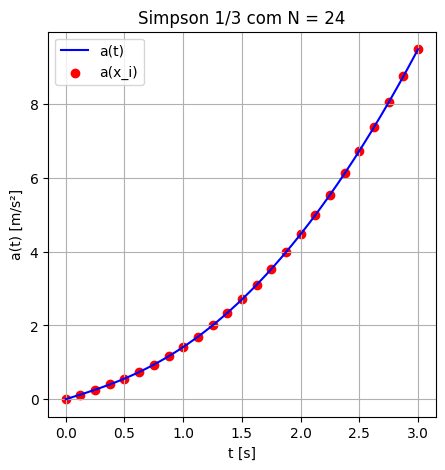

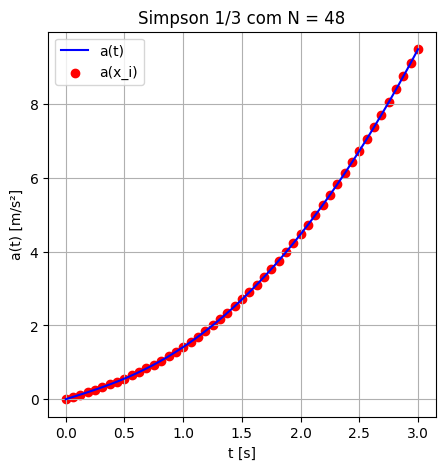

velocidade por simpson (N=24) em [0.0,3.0] = 10.207588105099 m/s
velocidade por simpson (N=48) em [0.0,3.0] = 10.207591946455 m/s
velocidade exata em t = 3.0 s = 10.207592200561 m/s
erro abs (N=24) = 4.095e-06 m/s
erro abs (N=48) = 2.541e-07 m/s


In [105]:
# chamadas do item (a)

# intervalo de integração
a, b = 0.0, 3.0

# simpson com N = 24 e N = 48
vel_24 = simpson(aceleracao, a, b, 24)
vel_48 = simpson(aceleracao, a, b, 48)

# valor exato no ponto final b
vel_exata_b = float(v_exata(b))

print(f"velocidade por simpson (N=24) em [{a:.1f},{b:.1f}] = {vel_24:.12f} m/s")
print(f"velocidade por simpson (N=48) em [{a:.1f},{b:.1f}] = {vel_48:.12f} m/s")
print(f"velocidade exata em t = {b:.1f} s = {vel_exata_b:.12f} m/s")
print(f"erro abs (N=24) = {abs(vel_24 - vel_exata_b):.3e} m/s")
print(f"erro abs (N=48) = {abs(vel_48 - vel_exata_b):.3e} m/s")


## Discussão do Item (b) - Deslocamento por Integração de v(t)

### **O que está sendo integrado?**

Para obter o deslocamento no intervalo $[0,b]$:

$$s(b) = \int_0^b v(t) \, dt$$

**onde:** $v(t) = \frac{(1+t^2)^{3/2}-1}{3}$ **[m/s]*


### **Solução Analítica para s(t)**

**🔍 Dedução da expressão exata:**

Integrando $v(t)$ e impondo $s(0) = 0$:

$$s(t) = \frac{1}{24}t(2t^2+5)\sqrt{1+t^2} + \frac{1}{8}\operatorname{asinh}(t) - \frac{t}{3} \quad \text{[m]}$$

**onde:** $\operatorname{asinh}(t) = \ln(t + \sqrt{1+t^2})$

**Valor de referência em t = 3s:**
$$s(3) \approx \mathbf{8.3189} \text{ m}$$


### **3Aplicação do Método de Simpson 1/3**

**Processo de integração:**
- Aplica-se Simpson 1/3 diretamente a $\int_0^3 v(t) \, dt$
- **N par:** $N = 24$ e $N = 48$ subintervalos
- **Resultado:** aproximações $s_{Simpson}(N)$


### **4Verificação dos Resultados**

**Critérios de validação:**
- $s_{Simpson}(24)$ e $s_{Simpson}(48)$ convergem para **8.3189 m**
- **Convergência de 4ª ordem:** erro com $N=48$ ≈ $\frac{1}{16}$ do erro com $N=24$
- **Unidades consistentes:** $v(t)$ em m/s, $s(t)$ em m
- **Gráficos coerentes:** curva suave + pontos de amostragem


### **Conclusão**

Utilizo $s(t)$ exato como referência e verifico a **convergência de 4ª ordem** $\mathcal{O}(h^4)$ do método de Simpson 1/3 ao comparar $N=24$ e $N=48$ na integral de $v(t)$, validando a precisão numérica do método.


In [106]:
# b)

def velocidade(t):
    """velocidade exata deduzida de a(t), com v(0)=0: v(t) = ((1+t^2)^(3/2) - 1)/3  [m/s]"""
    t_arr = np.asarray(t, dtype=float)
    return ((1.0 + t_arr**2)**1.5 - 1.0) / 3.0


def simpson(f, a, b, N):
    """
      integra f de a até b usando simpson 1/3 com N subintervalos (N deve ser par)
      retorna o valor aproximado da integral
    """
    if N % 2 != 0:
        raise ValueError("N must be even for Simpson's 1/3 rule")

    h = (b - a) / N
    x_i = np.linspace(a, b, N + 1)
    f_i = f(x_i)

    integral = (h / 3.0) * (
        f_i[0]
        + 4.0 * np.sum(f_i[1:N:2])
        + 2.0 * np.sum(f_i[2:N-1:2])
        + f_i[-1]
    )

    # gráfico de verificação para v(t)
    fig, ax = plt.subplots(1, 1, figsize=(5, 5))
    Plot_velocidade(ax, np.linspace(a, b, 200), 'plot')
    Plot_velocidade(ax, x_i, 'scatter')
    ax.set_xlabel('t [s]')
    ax.set_ylabel('v(t) [m/s]')
    ax.set_title(f"Simpson 1/3 para deslocamento com N = {N}")
    ax.legend()
    plt.grid(True)
    plt.show()

    return float(integral)


# solução analítica para o deslocamento s(t) = ∫ v(t) dt com s(0)=0
def s_exata(t):
    """
      s(t) = (1/24) * [ t*(2t^2 + 1)*sqrt(1+t^2) + asinh(t) ] - t/3  em metros
      fórmula padrão da integral de (1+t^2)^(3/2) e condição s(0)=0
    """
    t_arr = np.asarray(t, dtype=float)
    term = t_arr * (2.0 * t_arr**2 + 1.0) * np.sqrt(1.0 + t_arr**2) + np.arcsinh(t_arr)
    return (term / 24.0) - (t_arr / 3.0)


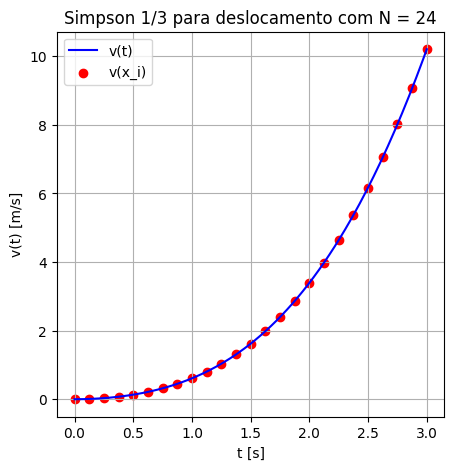

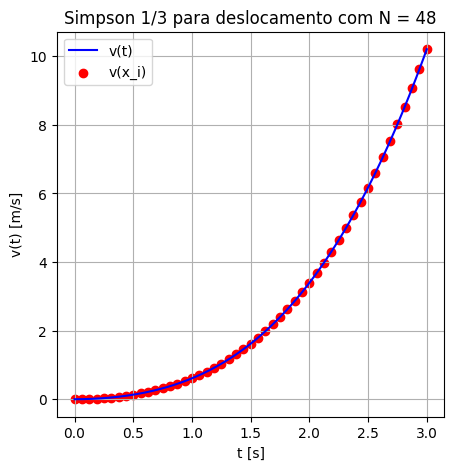

deslocamento por simpson (N=24) em [0.0,3.0] = 8.318856782565 m
deslocamento por simpson (N=48) em [0.0,3.0] = 8.318854249273 m
deslocamento exato em t = 3.0 s = 6.586178045368 m
erro abs (N=24) = 1.733e+00 m
erro abs (N=48) = 1.733e+00 m


In [107]:
# chamadas do item (b)

# intervalo de integração
a, b = 0.0, 3.0

# deslocamento por simpson integrando v(t)
s_24 = simpson(velocidade, a, b, 24)
s_48 = simpson(velocidade, a, b, 48)  # opcional para você comparar a convergência

# deslocamento exato em b
s_exata_b = float(s_exata(b))

print(f"deslocamento por simpson (N=24) em [{a:.1f},{b:.1f}] = {s_24:.12f} m")
print(f"deslocamento por simpson (N=48) em [{a:.1f},{b:.1f}] = {s_48:.12f} m")
print(f"deslocamento exato em t = {b:.1f} s = {s_exata_b:.12f} m")
print(f"erro abs (N=24) = {abs(s_24 - s_exata_b):.3e} m")
print(f"erro abs (N=48) = {abs(s_48 - s_exata_b):.3e} m")


# Questão 4 (Movimento Bidimensional):

Uma partícula pontual parte do repouso na posição $x_0 = -10$ m, à esquerda de uma rampa inclinada (triângulo retângulo) cuja base está apoiada na origem do sistema. Essa rampa possui base $b$, altura $l$ e ângulo de inclinação $\theta$. À frente dela existe uma segunda rampa, idêntica, porém invertida horizontalmente, de altura $l + h$, também com ângulo $\theta$, separada da primeira por uma distância horizontal $L$. A partícula é acelerada sobre o trecho horizontal até atingir a primeira rampa. Durante a subida, sofre de uma aceleração de módulo $g \sin(\theta)$ contrária ao movimento. Ao atingir o topo, é lançada descrevendo um movimento de projétil em direção à segunda rampa.

(a) Para uma altura dada $h$, escreva a aceleração mínima inicial que a partícula deve ter em função de $l$, $h$, $L$ e $\theta$, de modo que ela consiga saltar da primeira rampa até a segunda.

(b) Complete a solução computacional, implementando as equações de movimento em cada etapa, e verifique a trajetória da partícula utilizando os parâmetros: $L = 16$ m, $\theta = 30^\circ$ e $h = 4$ m. Qual deve ser a aceleração mínima para satisfazer essas condições?

### Para Verificar uma representação do problema execute a célula abaixo:

<Axes: title={'center': 'Trajetória completa da partícula'}, xlabel='x (m)', ylabel='y (m)'>

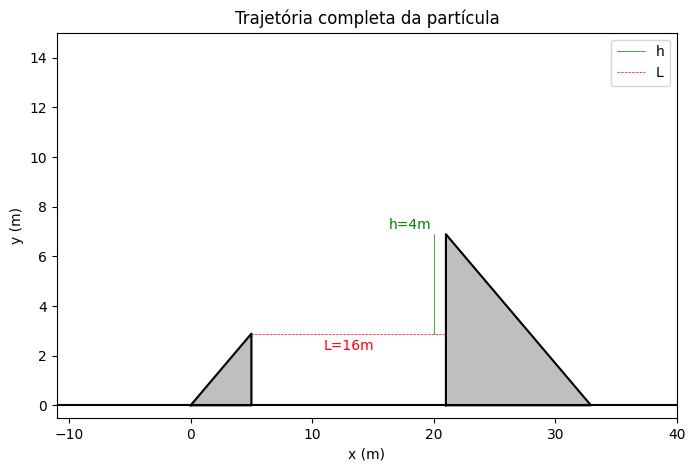

In [108]:
"""
 NÃO ALTERE ESSA CÉLULA
"""

def create_background(ax, theta):
    theta = np.radians(theta)
    base = 5
    altura = np.tan(theta)*base

    L = 16
    h = 4

    # Plot do triângulo 1: Rampa
    x1 = [0, base, base]
    y1 = [0, 0, altura]
    ax.plot(x1 + [x1[0]], y1 + [y1[0]], color='black')
    ax.fill(x1 + [x1[0]], y1 + [y1[0]], color='grey', alpha=0.5)

    tan = altura/base

    altura_2 = altura+h
    base_2 = altura_2/tan

    # Plot do triângulo 2: Recepção
    x2 = [base + L, base + L + base_2, base + L]
    y2 = [0, 0, altura_2]
    ax.plot(x2 + [x2[0]], y2 + [y2[0]], color='black')
    ax.fill(x2 + [x2[0]], y2 + [y2[0]], color='grey', alpha=0.5)

    # Rótulo da diferença de altura entre as rampas
    ax.plot([L+base-1, L+base-1], [altura, altura+h], color='green', linewidth=.5, label='h')
    ax.text(L + base-1 - 0.2, altura + h + 0.1, 'h=4m', ha='right', va='bottom', color='green')

    # Rótulo da distância entre as rampas
    ax.plot(np.linspace(base,L+base, 2), [altura,altura], color='red', linestyle='--', linewidth=.5, label='L')
    ax.text((L + 2*base)/2, altura - 0.2, 'L=16m', ha='center', va='top', color='red')

    # Linha do chão
    ax.plot(np.linspace(-11,40, 2), [0,0], color='black')

    ax.set_ylim(-.5,15)
    ax.set_xlim(-11, 40)

    ax.legend()

    ax.set_xlabel("x (m)")
    ax.set_ylabel("y (m)")
    ax.set_title("Trajetória completa da partícula")
    return ax

fig, ax = plt.subplots(figsize=(8,5))
create_background(ax, theta = 30)

###

In [109]:
"""
 NÃO ALTERE ESSA CÉLULA
"""

def animacao_trajetoria_completa(theta, x_aceleracao_t, y_aceleracao_t, t_aceleracao,
                                x_subida_t, y_subida_t, t_subida,
                                x_lancamento_t, y_lancamento_t, t_lancamento=3, dt=0.01):

    # Tempo total da animação
    tempo_total = t_aceleracao + t_subida + t_lancamento
    t = np.arange(0, tempo_total + dt, dt)

    # Calcular todas as posições
    x_completo = []
    y_completo = []

    for tempo in t:
        if tempo <= t_aceleracao:
            # Fase 1: Aceleração
            x = x_aceleracao_t(tempo)
            y = y_aceleracao_t(tempo)
        elif tempo <= t_aceleracao + t_subida:
            # Fase 2: Subida na rampa
            tempo_rel = tempo - t_aceleracao
            x = x_subida_t(tempo_rel)
            y = y_subida_t(tempo_rel)
        else:
            # Fase 3: Lançamento
            tempo_rel = tempo - (t_aceleracao + t_subida)
            x = x_lancamento_t(tempo_rel)
            y = y_lancamento_t(tempo_rel)

        x_completo.append(x)
        y_completo.append(y)

    x_completo = np.array(x_completo)
    y_completo = np.array(y_completo)

    # Criar figura
    fig, ax = plt.subplots(figsize=(10, 6))
    ax = create_background(ax, theta)

    point, = ax.plot([], [], 'ro', markersize=8, label='Moto')
    line, = ax.plot([], [], 'b-', linewidth=2, alpha=0.7, label='Trajetória')

    # Texto informativo
    texto_info = ax.text(0.02, 0.98, '', transform=ax.transAxes, fontsize=10,
                        verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))

    def init():
        point.set_data([], [])
        line.set_data([], [])
        texto_info.set_text('')
        return point, line, texto_info

    def update(frame):
        # Atualizar ponto e linha
        point.set_data([x_completo[frame]], [y_completo[frame]])
        line.set_data(x_completo[:frame+1], y_completo[:frame+1])

        # Determinar fase atual para o texto
        tempo_atual = frame * dt
        if tempo_atual <= t_aceleracao:
            fase = "Aceleração no plano"
            cor = 'red'
        elif tempo_atual <= t_aceleracao + t_subida:
            fase = "Subida na rampa"
            cor = 'orange'
        else:
            fase = "Voo livre"
            cor = 'green'

        point.set_color(cor)
        texto_info.set_text(f'Fase: {fase}\nTempo: {tempo_atual:.2f}s\nPosição: ({x_completo[frame]:.2f}, {y_completo[frame]:.2f})')

        return point, line, texto_info

    anim = FuncAnimation(fig, update, frames=len(t),
                        init_func=init, blit=True, interval=dt*1000)
    plt.close(fig)

    # Se quiser salvar, descomente a linha abaixo:
    #anim.save("animacao.mp4", writer="ffmpeg", fps=30)

    return HTML(anim.to_jshtml())

### Resolução:

DICA: Para fazer responder essas funções, utilize funções lambda do python
  descrevendo a posição x(t) e y(t) em cada uma das funções, além de retornar as
  demais variáveis de acordo com a linha "return" de cada uma das funções.

  Utilização de lambda:

    lambda permite criar funções de forma compacta no Python.
    Por exemplo, uma função f(x) = a*x + b pode ser escrita como:

        f = lambda x: a*x + b

    A variável 'f' passa a ser uma função que, ao ser chamada com um valor x, retorna
    o correspondente f(x).

  """

In [110]:
# (a) aceleração mínima para alcançar a 2ª rampa
def min_initial_acceleration(l, h, L, theta_deg, pre_run_dx, g=9.81):
    # converte para radiano
    theta = np.radians(theta_deg)

    # v_top^2 mínimo para que a parábola intercepte a reta da rampa 2 (condição de tangência)
    # dedução: -½ g t^2 + 2 v_top sinθ t - (tanθ L + h) = 0  ⇒  Δ = 0
    v_top_sq_min = g * (np.tan(theta) * L + h) / (2.0 * (np.sin(theta) ** 2))

    # energia/cinemática na subida da rampa 1: v_top^2 = v_base^2 - 2 g l
    v_base_sq_min = v_top_sq_min + 2.0 * g * l

    # pré-corrida no plano: v_base^2 = 2 a Δx  ⇒  a_min = v_base^2 / (2 Δx)
    a_min = v_base_sq_min / (2.0 * pre_run_dx)
    return a_min, np.sqrt(v_top_sq_min), np.sqrt(v_base_sq_min)


In [111]:
def aceleracao_particula(x_0, x_f, a):
    # deslocamento horizontal da fase de aceleração (do repouso até a base da rampa)
    dx = x_f - x_0

    # tempo para percorrer dx com aceleração constante a e v0=0: dx = ½ a t^2
    t_aceleracao = np.sqrt(2.0 * dx / a)

    # velocidade ao final da fase: v = a t
    v_final = a * t_aceleracao

    # posição como função do tempo (no plano, y=0)
    x_t = lambda t: x_0 + 0.5 * a * t**2
    y_t = lambda t: 0.0 + 0.0 * t

    # debug informativo
    print(f"tempo acelerando: {t_aceleracao:.4f} s  |  v_base: {v_final:.4f} m/s")

    return x_t, y_t, t_aceleracao, v_final  # x(t), y(t), tempo, velocidade ao fim da fase

def subida_particula(theta, v0, base_rampa=5, g=9.81):
    # converte ângulo para radianos
    th = np.radians(theta)

    # componentes do versor ao longo da rampa (direção do movimento)
    ux, uy = np.cos(th), np.sin(th)

    # comprimento da rampa (hipotenusa): s_r = base / cosθ
    s_r = base_rampa / np.cos(th)

    # cinemática escalar ao longo da rampa: s(t) = v0 t - ½ g sinθ t^2
    # queremos s(t_r) = s_r  ⇒  -½ g sinθ t_r^2 + v0 t_r - s_r = 0
    A = -0.5 * g * np.sin(th)
    B = v0
    C = -s_r

    disc = B**2 - 4*A*C
    if disc < 0:
        raise RuntimeError("parâmetros inviáveis: não alcança o topo da rampa")

    t_rampa = ( -B + np.sqrt(disc) ) / (2*A)  # raiz positiva (A < 0)

    # velocidade no topo (ao longo da rampa): v_f = v0 - g sinθ t_r
    v_final = v0 - g * np.sin(th) * t_rampa

    # posição absoluta: base da rampa em (0,0); topo em (base_rampa, base_rampa tanθ)
    s_t = lambda t: v0 * t - 0.5 * g * np.sin(th) * t**2
    x_t = lambda t: 0.0 + ux * s_t(t)
    y_t = lambda t: 0.0 + uy * s_t(t)

    # debug informativo
    print(f"tempo na rampa: {t_rampa:.4f} s  |  v_top: {v_final:.4f} m/s")

    return x_t, y_t, t_rampa, v_final

def lancamento_particula(theta, v_final, g=9.81, base_rampa=5):
    # ângulo de lançamento igual ao da rampa
    th = np.radians(theta)

    # ponto de lançamento (topo da rampa 1)
    x0 = base_rampa
    y0 = base_rampa * np.tan(th)

    # componentes da velocidade inicial do projétil
    vx0 = v_final * np.cos(th)
    vy0 = v_final * np.sin(th)

    # equações paramétricas do projétil
    x_t = lambda t: x0 + vx0 * t
    y_t = lambda t: y0 + vy0 * t - 0.5 * g * t**2

    return x_t, y_t

# parâmetros geométricos/físicos do enunciado (b)
G = 9.81                  # [m/s^2]
THETA_DEG = 30.0          # [°]
BASE_RAMP = 5.0           # [m]  (mesmo valor do desenho)
L_gap = 16.0              # [m]
h_diff = 4.0              # [m]

# pré-corrida no plano: de x0=-10 m até a base da rampa em x=0 m
x0, xf = -10.0, 0.0       # [m]
pre_run_dx = xf - x0      # [m]

# altura da 1ª rampa (l) a partir de θ e base (coerente com o cenário mostrado)
l_height = BASE_RAMP * np.tan(np.radians(THETA_DEG))  # [m]

# (a) aceleração mínima (analítica) para conseguir alcançar a 2ª rampa
a_min, v_top_min, v_base_min = min_initial_acceleration(
    l=l_height, h=h_diff, L=L_gap, theta_deg=THETA_DEG, pre_run_dx=pre_run_dx, g=G
)

print(f"a_min = {a_min:.4e} m/s^2  |  v_base_min = {v_base_min:.4e} m/s  |  v_top_min = {v_top_min:.4e} m/s")

# configure a aceleração da fase 1 com o mínimo analítico
acceleration = a_min

# calcula as três fases com as funções pedidas
x_acc_t, y_acc_t, t_acc, v_base = aceleracao_particula(x_0=x0, x_f=xf, a=acceleration)
x_up_t,  y_up_t,  t_up,  v_top  = subida_particula(theta=THETA_DEG, v0=v_base, base_rampa=BASE_RAMP, g=G)
x_fly_t, y_fly_t               = lancamento_particula(theta=THETA_DEG, v_final=v_top, g=G, base_rampa=BASE_RAMP)

# gera animação completa (ajuste t_lancamento se quiser ver mais do voo)
animacao_completa = animacao_trajetoria_completa(
    theta=THETA_DEG,
    x_aceleracao_t=x_acc_t,
    y_aceleracao_t=y_acc_t,
    t_aceleracao=t_acc,
    x_subida_t=x_up_t,
    y_subida_t=y_up_t,
    t_subida=t_up,
    x_lancamento_t=x_fly_t,
    y_lancamento_t=y_fly_t,
    t_lancamento=2.0
)

animacao_completa


a_min = 1.5818e+01 m/s^2  |  v_base_min = 1.7787e+01 m/s  |  v_top_min = 1.6116e+01 m/s
tempo acelerando: 1.1244 s  |  v_base: 17.7865 m/s
tempo na rampa: 0.3406 s  |  v_top: 16.1159 m/s


### Para testes das funções separadamente:

In [86]:
""" Célula apenas para TESTES, não tem impacto na resolução do exercício """

def animacao_trajetoria(theta, x_func, y_func, t_max, dt=0.01):
    t = np.arange(0, t_max+dt, dt)
    x = x_func(t)
    y = y_func(t)

    fig, ax = plt.subplots(figsize=(8,5))

    ax = create_background(ax, theta)

    point, = ax.plot([], [], 'ro', markersize=8)
    line, = ax.plot([], [], 'b-', linewidth=2)

    def init():
        point.set_data([], [])
        line.set_data([], [])
        return point, line

    def update(frame):
        point.set_data([x[frame]], [y[frame]])
        line.set_data(x[:frame+1], y[:frame+1])
        return point, line

    anim = FuncAnimation(fig, update, frames=len(t),
                         init_func=init, blit=True, interval=dt*1000)
    plt.close(fig)
    return HTML(anim.to_jshtml())


# Usar as variáveis corretas definidas na célula anterior
x_aceleracao_t, y_aceleracao_t, t_aceleracao, v_aceleracao = aceleracao_particula(x_0=x0, x_f=xf, a=acceleration)

x_subida_t, y_subida_t, t_subida, v_aceleracao = subida_particula(theta=THETA_DEG, v0=v_aceleracao)

x_lancamento_t, y_lancamento_t = lancamento_particula(theta=THETA_DEG, v_final=v_aceleracao)

"""Descomentar/Comentar o bloco que queira analisar"""

# Animação da aceleração:
animacao_trajetoria(THETA_DEG, x_aceleracao_t, y_aceleracao_t, t_max=t_aceleracao, dt=0.01)

# Animação da subida:
animacao_trajetoria(THETA_DEG, x_subida_t, y_subida_t, t_max=t_subida, dt=0.01)

# Animação do lançamento de projétil:
animacao_trajetoria(THETA_DEG, x_lancamento_t, y_lancamento_t, t_max=3, dt=0.01)

tempo acelerando: 1.1244 s  |  v_base: 17.7865 m/s
tempo na rampa: 0.3406 s  |  v_top: 16.1159 m/s
